### Experiments based on projects done by other course students

In [0]:
!curl -s https://course.fast.ai/setup/colab | bash

In [0]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)
root_dir = "/content/gdrive/My Drive/Colab Data/"
base_dir = root_dir + 'fastai-v3/'

In [0]:
from fastai import *
from fastai.vision import *

### Handwritten Devnagiri character recognition
"DHCD dataset - A Devnagiri MNIST" - [posted here](https://forums.fast.ai/t/share-your-work-here/27676/38), [dataset](https://archive.ics.uci.edu/ml/datasets/Devanagari+Handwritten+Character+Dataset), [github code](https://gist.github.com/suvash/d9fe3aa8d570d42ab65175a057d402a4)

In [0]:
!wget 'https://archive.ics.uci.edu/ml/machine-learning-databases/00389/DevanagariHandwrittenCharacterDataset.zip'

In [0]:
!unzip DevanagariHandwrittenCharacterDataset.zip

In [0]:
!(cd DevanagariHandwrittenCharacterDataset; mv Train train; mv Test valid)

In [0]:
path = Path("DevanagariHandwrittenCharacterDataset"); path.ls()

[PosixPath('DevanagariHandwrittenCharacterDataset/valid'),
 PosixPath('DevanagariHandwrittenCharacterDataset/train')]

In [0]:
data = ImageDataBunch.from_folder(path, size=26)

In [0]:
data.show_batch(rows=6, figsize=(11,11))

In [0]:
print(data.classes)

['character_10_yna', 'character_11_taamatar', 'character_12_thaa', 'character_13_daa', 'character_14_dhaa', 'character_15_adna', 'character_16_tabala', 'character_17_tha', 'character_18_da', 'character_19_dha', 'character_1_ka', 'character_20_na', 'character_21_pa', 'character_22_pha', 'character_23_ba', 'character_24_bha', 'character_25_ma', 'character_26_yaw', 'character_27_ra', 'character_28_la', 'character_29_waw', 'character_2_kha', 'character_30_motosaw', 'character_31_petchiryakha', 'character_32_patalosaw', 'character_33_ha', 'character_34_chhya', 'character_35_tra', 'character_36_gya', 'character_3_ga', 'character_4_gha', 'character_5_kna', 'character_6_cha', 'character_7_chha', 'character_8_ja', 'character_9_jha', 'digit_0', 'digit_1', 'digit_2', 'digit_3', 'digit_4', 'digit_5', 'digit_6', 'digit_7', 'digit_8', 'digit_9']


In [0]:
learn = cnn_learner(data, models.resnet34, metrics=error_rate)
learn.fit_one_cycle(4)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.torch/models/resnet34-333f7ec4.pth
87306240it [00:01, 84966508.13it/s]


epoch,train_loss,valid_loss,error_rate,time
0,1.416107,1.008373,0.290942,01:47
1,0.635906,0.395822,0.119058,01:45
2,0.418469,0.268775,0.082971,01:46
3,0.343759,0.241309,0.075072,01:44


### Plant identification

Info - [posted here](https://forums.fast.ai/t/share-your-work-here/27676/5), [dataset](https://www.imageclef.org/2013/plant), [github code](https://gist.github.com/hkristen/696d5111692c25c9ae0d6949501e9215)

NB: Dataset is 3-4GB, so haven't completed it.

In [0]:
import glob
import xml.etree.ElementTree as ET
import pandas as pd
import os

In [0]:
!wget http://otmedia.lirmm.fr/LifeCLEF/ImageCLEF2011-2012-2013/ImageCLEF2013PlantTaskTestAndTaskPackage.zip
!wget http://otmedia.lirmm.fr/LifeCLEF/ImageCLEF2011-2012-2013/ImageCLEF2013PlantTaskTrainPackage-PART-1.zip
!wget http://otmedia.lirmm.fr/LifeCLEF/ImageCLEF2011-2012-2013/ImageCLEF2013PlantTaskTrainPackage-PART-2.zip

### Recognise Artists (my own experiment)
Distinguish between paintings of Picasso, Cezanne, Van Gogh, Titian 

**Download Images**

Search for each artists images in Google Images, one artist at a time. Scroll down till the bottom until you see a button that says 'Show more results'.

Press CtrlShiftJ to open the browser's debug  'Console' and paste the following command, which will download a file containing URLs for all the images. Rename that file to <artist>_url.txt

urls = Array.from(document.querySelectorAll('.rg_di .rg_meta')).map(el=>JSON.parse(el.textContent).ou);
window.open('data:text/csv;charset=utf-8,' + escape(urls.join('\n')));

In [0]:
folder = 'picasso'
file = 'picasso_url.txt'

In [0]:
path = Path(base_dir + 'data/artists')
dest = path/folder
dest.mkdir(parents=True, exist_ok=True)

In [0]:
download_images(path/file, dest, max_pics=200)

Error https://content3.cdnprado.net/imagenes/Documentos/imgsem/65/657f/657fa964-0040-48df-971e-88f0de5c6714/73389a57-cd89-42f6-9458-c3f635bfcd39.jpg HTTPSConnectionPool(host='content3.cdnprado.net', port=443): Read timed out. (read timeout=4)
Error https://content3.cdnprado.net/imagenes/Documentos/imgsem/0f/0f35/0f359b90-2055-4326-bbbe-775dbfa7c504/ea16571c-2e85-4603-9a17-69f777ef7449.jpg HTTPSConnectionPool(host='content3.cdnprado.net', port=443): Read timed out. (read timeout=4)
Error https://content3.cdnprado.net/imagenes/Documentos/imgsem/82/821a/821a6867-321a-4570-a19a-db4da7e2042c/e2377d3a-e928-41a3-062f-94417ba14df7.jpg HTTPSConnectionPool(host='content3.cdnprado.net', port=443): Read timed out. (read timeout=4)
Error https://content3.cdnprado.net/imagenes/Documentos/imgsem/a2/a27a/a27a3d6f-fe1c-4f66-b976-aa660b005784/d7f1538a-fb57-484a-8caf-487d53ac1761.jpg HTTPSConnectionPool(host='content3.cdnprado.net', port=443): Read timed out. (read timeout=4)


In [0]:
# We will repeat the above two steps with Cezanne images....
folder = 'cezanne'
file = 'cezanne_url.txt'

In [0]:
# We will repeat the steps with Van Gogh images....
folder = 'vangogh'
file = 'vangogh_url.txt'

In [0]:
# We will repeat the steps with Titian images....
folder = 'titian'
file = 'titian_url.txt'

In [0]:
# Then we can remove any images that can't be opened
classes = ['picasso','cezanne','vangogh', 'titian']
for c in classes:
    print(c)
    verify_images(path/c, delete=True, max_size=500)

**Load Image Data**

In [0]:
# Load image data from the downloaded folders
np.random.seed(42)
data = ImageDataBunch.from_folder(path, train=".", valid_pct=0.2,
        ds_tfms=get_transforms(), size=224, num_workers=4).normalize(imagenet_stats)
data.classes, data.c, len(data.train_ds), len(data.valid_ds)

['cezanne', 'picasso', 'titian', 'vangogh']

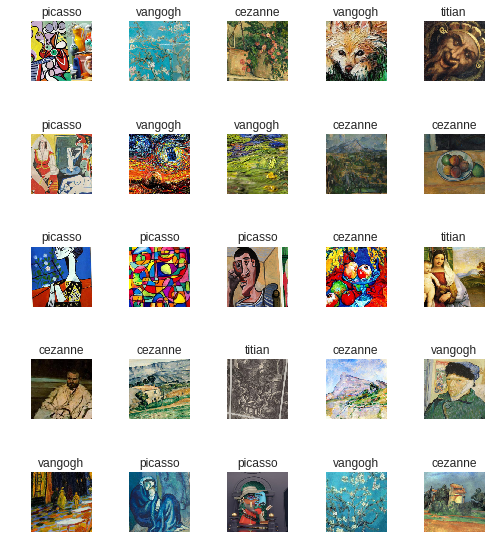

In [0]:
data.show_batch(rows=5, figsize=(7,8))

**Transfer Learning: Train a Resnet34 CNN**

In [0]:
learn = cnn_learner(data, models.resnet34, metrics=error_rate)
learn.fit_one_cycle(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.365704,0.526929,0.172185,00:14
1,0.835515,0.273247,0.079470,00:14
2,0.607318,0.219055,0.072848,00:14
3,0.488327,0.207171,0.072848,00:14


**Check Results**

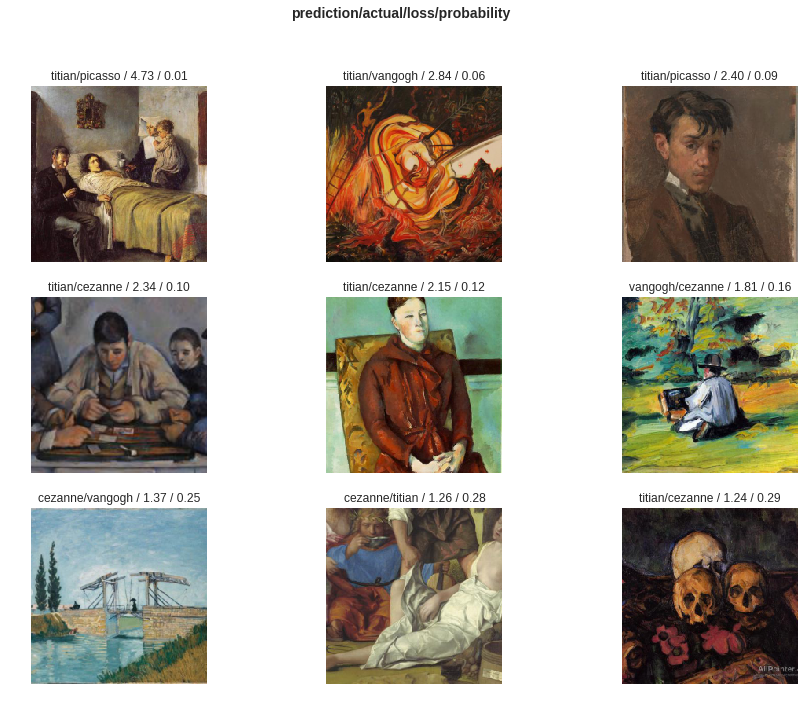

In [0]:
# Show predictions which were most incorrect
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_top_losses(9, figsize=(15,11), heatmap = False)

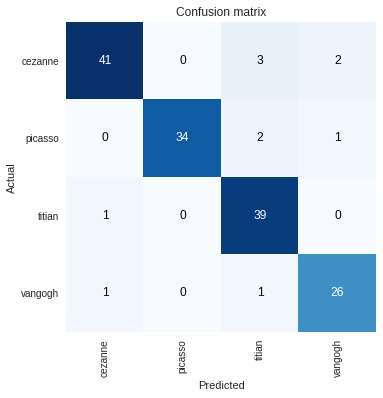

In [0]:
interp.plot_confusion_matrix()

**Re-learn by updating even the initial CNN layers (which were frozen before)**

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


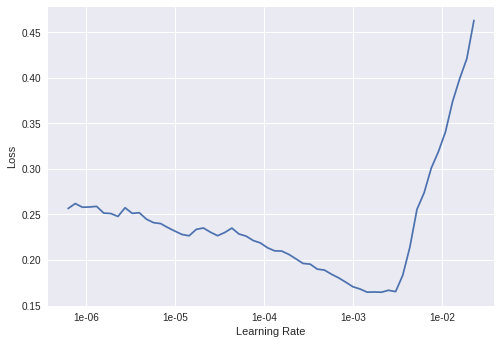

In [0]:
# Unfreeze the initial CNN layers so those weights can also get updated during learning
learn.unfreeze()

# Plot prediction loss against learning rate
learn.lr_find()
learn.recorder.plot()

In [0]:
learn.unfreeze()
learn.fit_one_cycle(8, max_lr=slice(1e-5,1e-3))

epoch,train_loss,valid_loss,error_rate,time
0,0.057220,0.160200,0.052980,00:13
1,0.065729,0.131767,0.019868,00:13
2,0.056928,0.126397,0.033113,00:13
3,0.049417,0.176653,0.052980,00:12
4,0.043578,0.167440,0.046358,00:13
5,0.038671,0.164558,0.039735,00:13
6,0.031878,0.154897,0.046358,00:13
7,0.027190,0.156118,0.046358,00:13


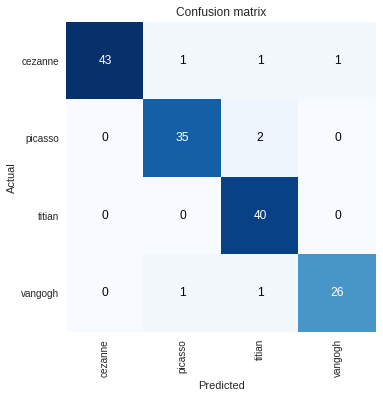

In [0]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [0]:
# Show correctly classified images as well
learn.show_results(rows=8, figsize=(7,8))

### Continue artist recognition - Use tSNE to visualise the classification results
Based on [this post](https://forums.fast.ai/t/share-your-work-here/27676/53), [github code](https://github.com/kheyer/ML-DL-Projects/blob/master/Pets%20TSNE/pets_tsne.ipynb)

**Explore the Results data structures - this is just experimentation**

Predicted values for item  44  are  tensor([2.4732e-06, 2.3686e-05, 9.9910e-01, 8.7868e-04]) and actual is  tensor(2)
Predicted Class is  titian
Actual class is  titian


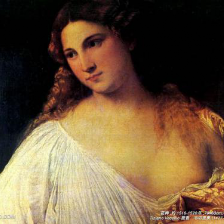

In [0]:
# Get predicted and actual values
preds = learn.get_preds()
y_pred = preds[0]
y_targ = preds[1]

# Sample item in validation data set
item = 44
# Sample item predicted values for each class and actual target value
print ('Predicted values for item ', item, ' are ', y_pred[item], 'and actual is ', y_targ[item])

#We can use a softmax function to turn the output vector into a vector of probabilities for the image beloning to each class.
# Get the class corresponding to the max probability
print ('Predicted Class is ', learn.data.classes[np.argmax(to_np(F.softmax(y_pred[item], dim=0)))])
print ('Actual class is ', learn.data.classes[to_np(y_targ[item])])

# Image corresponding to that item
learn.data.valid_ds[item][0]

**The real tSNE logic starts here**

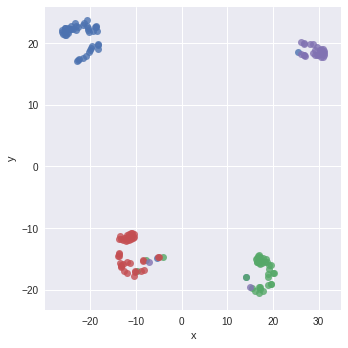

In [0]:
from sklearn.manifold import TSNE
import seaborn as sns
from sklearn import manifold, datasets
#from sklearn.metrics.pairwise import pairwise_distances
#from sklearn.metrics import confusion_matrix
#from scipy.spatial.distance import squareform
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
#from matplotlib.ticker import NullFormatter
import PIL # Python Image Library

# We can perform t-SNE on our model's predicted value vectors. As these vectors are from 
# the final classification, we would expect them to cluster well.

# probs_trans is an array of [[x,y], ....] coordinates for each sample
probs_trans = manifold.TSNE(n_components=2, perplexity=15).fit_transform(y_pred)

# concat the x,y coordinates with the target label for each sample
# Each row is a sample, and the columns are [x, y, label]
prob_df = pd.DataFrame(np.concatenate((probs_trans, y_targ[:,None]), axis=1), columns=['x','y','labels'])

# Plot the tSNE visualisation
g = sns.lmplot('x', 'y', data=prob_df, hue='labels', fit_reg=False, legend=False)

# Add the actual images corresponding to each sample to the dataframe
# These images are Fastai Image classes and contain data of shape (3, width, height)
prob_df['img'] = learn.data.valid_ds.x

**Now plot the tSNE using image thumbnails instead of dots**

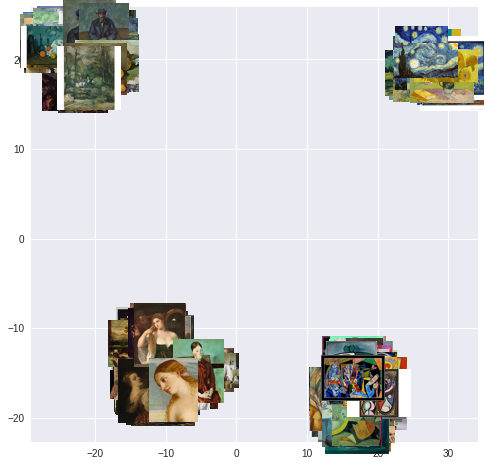

In [0]:
#--------------------------------------------------------------
# Convert Fastai Image class to a PIL Image class
#--------------------------------------------------------------
def convertFastImagetoPIL (imFast):
  # Numpy array of Fastai Image data
  # It's shape is (width, height, 3) for 3 RGB channels
  # Numbers are signed floats between 0-1
  imFastRaw = np.array (imFast.data)

  # Channel axis (ie. first axis) needs to be moved to last axis
  imFastSwap = np.swapaxes (imFastRaw, 0, 1).swapaxes (1, 2)

  # Scale the values from 0-1 to 0-255, round them to integer values and
  # convert to unsigned ints
  imFastArray = np.round(imFastSwap * 255).astype('uint8')

  # Now convert the transformed array to a PIL Image
  imPilConvert = Image.fromarray(imFastArray)
  return (imPilConvert)


def visualize_scatter_with_images(scaled_data, df, figsize=(8,8), image_zoom=1, suffix=1):
    fig, ax = plt.subplots(figsize=figsize)
    
    # NB: These are matplotlib artists, nothing to do with my artist recognition example
    artists = [] 
    
    # X and Y coordinates of data points
    xx = scaled_data[:,0]
    yy = scaled_data[:,1]
    
    # Loop through every data point
    for i, (x,y) in enumerate(zip(xx,yy)):
      
        # Get the Fastai Image and convert to PIL Image class
        imf = df['img'][i]
        im = convertFastImagetoPIL (imf)
        
        # Shrink to thumbnail size
        im.thumbnail((64,64))
        
        # Plot the thumbnail at the (x,y) coordinate of the data point
        img = OffsetImage(im, zoom=image_zoom, cmap='gray')
        ab = AnnotationBbox(img, (x, y), xycoords='data', frameon=False)
        artists.append(ax.add_artist(ab))
   
    ax.update_datalim(np.column_stack([xx,yy]))
    ax.autoscale()
    
    #fig.savefig(f'TSNE_{suffix}.jpg', bbox_inches = 'tight')
    return fig, ax
  
fig, ax = visualize_scatter_with_images(probs_trans, prob_df, image_zoom=1, suffix='probabilities')
plt.show()

### Image Manipulation (using PIL Python Image Library and Fastai Image class)
Depends on first running the Artists Recognition

**Example: Use PIL to open and manipulate an image**

PIL version is  4.1.1


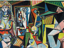

In [0]:
from PIL import Image               # to load images
print('PIL version is ', PIL.PILLOW_VERSION)

from IPython.display import display # to display images

# Load the image from a file
imPil = PIL.Image.open(path/'picasso/00000196.jpg')

# Shrink that image to a thumbnail
imPil.thumbnail((64,64))

# Display the image
display(imPil)

**Example: Use Fastai Image class to manipulate an image**

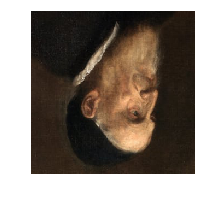

In [0]:
# Get the 4th image from the tSNE data above
imFast = prob_df['img'][4]

# Rotate it
imFast.rotate(180).show()

**Example: Convert from Fastai Image class to PIL Image class**

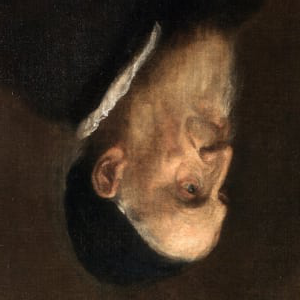

In [0]:
# Numpy array of PIL image data - just to see it's format
imPilArray = np.array(imPil)

# Shape is (3, width, height) for 3 RGB channels
# Also, the numbers are unsigned ints between 0-255
imPilArray.shape

# Numpy array of Fastai Image data
# It's shape is (width, height, 3) for 3 RGB channels
# Numbers are signed floats between 0-1
imFastRaw = np.array (imFast.data)

# Channel axis (ie. first axis) needs to be moved to last axis
imFastSwap = np.swapaxes (imFastRaw, 0, 1).swapaxes (1, 2)

# Scale the values from 0-1 to 0-255, round them to integer values and
# convert to unsigned ints
imFastArray = np.round(imFastSwap * 255).astype('uint8')

# Now convert the transformed array to a PIL Image
imPilConvert = Image.fromarray(imFastArray)

display (imPilConvert)

###Animating gradient descent - [posted here](https://forums.fast.ai/t/share-your-work-here/27676/300), [notebook](https://nbviewer.jupyter.org/gist/joshfp/85d96f07aaa5f4d2c9eb47956ccdcc88/lesson2-sgd-in-action.ipynb)

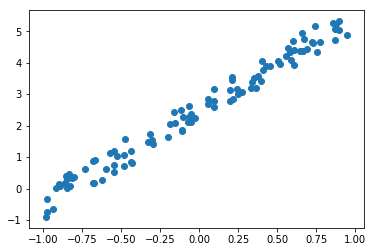

In [0]:
#-------------------------------
# Linear Regression
#-------------------------------

n = 100
v_target = 3.0 # Weight 1
w_target = 2   # Weight 2

# x is [[x1, 1.0],
#       [x2, 1.0],
#        .....
#       [xn, 1.0]]
# where x1..xn are uniformly random
x = torch.ones(n, 2)
x[:,0].uniform_(-1., 1)

# Generate y vector values along a line as y = x1 * v_target + 1.0 * w_target, plus some
# random delta
weights_target = torch.tensor([v_target, w_target])
y = x@weights_target + torch.rand(n)

# Plot the y vector values
plt.scatter(x[:,0], y);

In [0]:
#-------------------------------
# Plot the loss
#-------------------------------
# Calculate the Loss for every possible value of our weights v and w. 
# The lowest loss should occur at the (v_target, w_target) point, and the loss
# increases in all directions, the further you move away from it

# Loss is calculated as Mean Square Error
def mse(y_hat, y): return ((y_hat-y)**2).mean()

# Calculate the loss for one combination of (v, w) values
def loss_wrt_wgts(v, w):
  
    # Calculate predicted value vector y_hat for this combination of weights
    weights = torch.Tensor([v, w])
    y_hat = x@weights
    
    # Return MSE between the actual value vector (y) and predicted 
    # value vector (y_hat)
    return mse(y_hat, y)
loss_wgts = np.vectorize(loss_wrt_wgts)

# Generate values along the V and W axes
# Shape (50,) - [-20, ...., 20]
v_range = np.linspace(-20, 20, 50)
w_range = np.linspace(-20, 20, 50)

# Mesh contains two 2D arrays [[V-Grid], [W-Grid]] 
# V-Grid is [[v0, v1, .... vn],
#            [v0, v1, .... vn],
#              ....
#            [v0, v1, .... vn]]
#
# W-Grid is [[w0, w0, .... w0],
#            [w0, w0, .... w0],
#              ....
#            [w0, w0, .... w0]]
mesh = np.meshgrid(v_range, w_range)

# The *mesh passes the two arrays as two separate array arguments to loss_wgts.
# ie. loss_wgts (V-Grid, W-Grid)
# Since loss_wgts is a np.vectorize() function, it flattens out each array into
# scalars, and then passes them one by one into loss_wrt_wgts
# ie. loss_wrt_wgts(v0, w0) followed by loss_wrt_wgts(v1, w0) etc.
# So loss_wrt_wgts is called n * m times.
loss_mesh = loss_wgts(*mesh)

from mpl_toolkits import mplot3d

# The V and W axes are the horizontal plane at the bottom of the 3D plot below
# And the Loss is along the vertical axis
fig = plt.figure(figsize=(12,12))
ax = plt.axes(projection='3d')
ax.plot_surface(*mesh, loss_mesh, cmap='viridis', alpha=0.8)
ax.set_xlabel('v'); ax.set_ylabel('w'); ax.set_zlabel('Loss')
ax.view_init(30, 20)

In [0]:
#-------------------------------
# Gradient Descent
#-------------------------------
def update(w):
    y_hat = x@w
    loss = mse(y, y_hat)
    prev_wgts = w.data.clone()   
    loss.backward()
    with torch.no_grad():
        w -= lr * w.grad
        w.grad.zero_()
    return prev_wgts, loss.item()

def train(w0):
    recorder = []
    w = torch.tensor(w0, requires_grad=True)
    for t in range(n_epochs): recorder.append(update(w))
    rec_wgts, rec_loss = [list(o) for o in zip(*recorder)]
    rec_wgts = torch.stack(rec_wgts)
    return rec_wgts, rec_loss

# hyper parameters
lr = 0.1
n_epochs = 100

# initial parameters (weights)
w0 = [-18., -18.]

In [0]:
#-------------------------------
# Animate
#-------------------------------
from matplotlib import animation
from matplotlib.gridspec import GridSpec
plt.rc('animation', html='jshtml')

fig = plt.figure(figsize=(14, 8))
gs = GridSpec(2, 2, width_ratios=[1, 2.5])

# plot ground truth & model
ax0 = fig.add_subplot(gs[0,0])
ax0.scatter(x[:,0], y, c='orange', label='Ground truth')
ax0.set_ylim(-1, 6)
ax0.set_title('Ground truth & Model', fontsize=16)
line0, = ax0.plot([], [], label='Model')
ax0.legend(loc='lower right')

# plot loss 
ax1 = fig.add_subplot(gs[:,1], projection='3d')
ax1.set_title('Loss', fontsize=16, pad=20)
ax1.plot_surface(*mesh, loss_mesh, cmap='viridis', alpha=0.8)
# Mark the global minimum which will be at the target weight
ax1.plot3D([weights_target[0]], [weights_target[1]], [0], c='r', marker='x', markersize=10, 
           label='Global minimum', linewidth=0)
line1, = ax1.plot3D([], [], [], c='r', marker='o', alpha=0.4, label='loss')
ax1.set_xlabel('w0'); ax1.set_ylabel('w1'); ax1.set_zlabel('Loss')
ax1.view_init(30, 20)
ax1.legend()

# plot weights & loss
ax2 = fig.add_subplot(gs[1,0])
ax2.set_title('Weights & Loss', fontsize=16)
line2, = ax2.plot([],[], label='w0')
line3, = ax2.plot([],[], label='w1')
ax2.set_ylim(-20, 5)
ax2.set_xlim(0, n_epochs)
ax2.set_xlabel('epochs')
ax2.set_ylabel('weights')
ax3 = ax2.twinx()
line4, = ax3.plot([],[], label='loss', c='r')
ax3.set_ylabel('loss')
ax3.set_ybound(0, 500)
ax2.legend((line2, line3, line4), ('w0', 'w1', 'loss'), loc='center right')

ttl = fig.suptitle(f'lr: {lr} - Epoch: 0/{n_epochs}', fontsize=22)
fig.tight_layout()
fig.subplots_adjust(top=0.85)
plt.close()

def animate(i):   
    line0.set_data(x[:,0].numpy(), (x@rec_wgts[i]).numpy())
    line1.set_data(rec_wgts[:i+1,0].numpy(), rec_wgts[:i+1,1].numpy())
    line1.set_3d_properties(rec_loss[:i+1])
    epochs = np.arange(i+1)
    line2.set_data(epochs, rec_wgts[:i+1, 0].numpy())
    line3.set_data(epochs, rec_wgts[:i+1, 1].numpy())
    line4.set_data(epochs, rec_loss[:i+1])
    ttl.set_text(f'lr: {lr} - Epoch: {i+1}/{n_epochs}')
    return line0, line1, line2, line3, line4, ttl

In [0]:
# Train the model
# Get back Weights and Loss at each iteration
lr = 0.1
rec_wgts, rec_loss = train(w0)
animation.FuncAnimation(fig, animate, range(n_epochs), interval=40)

Animation size has reached 21251093 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [0]:
#-------------------------------
# Visualise different learning rates
#-------------------------------
lr = 0.01
rec_wgts, rec_loss = train(w0)
animation.FuncAnimation(fig, animate, range(n_epochs), interval=40)

### Classifying ordinary sounds using spectrogram images

Example - [posted here](https://forums.fast.ai/t/share-your-work-here/27676/40), [notebook](https://github.com/etown/dl1/blob/master/UrbanSoundClassification.ipynb), [dataset](https://urbansounddataset.weebly.com/urbansound8k.html)

In [0]:
# Download the audio dataset (5.61GB)
!wget https://goo.gl/8hY5ER
!tar xf 8hY5ER
!ls UrbanSound8K/audio/

# Create the directories to be used later for saving output
!mkdir 'UrbanSound8K/spectrogram'
!mkdir 'UrbanSound8K/data'

In [0]:
# Listen to one sound sample
import IPython
IPython.display.Audio("UrbanSound8K/audio/fold1/26270-9-0-35.wav")

In [0]:
#-----------------------------------------------------------------------------
# 
# The original data contains an "..../audio/" folder with ten sub-folders, each
# corresponding to one Cross-Validation fold. The audio files in each sub-folder
# are a mixture of all label classes
#
# Generate spectrograms for each audio file and save them in another folder
# called "..../spectrogram" and whose sub-folders mirror the "audio" folder
#
#-----------------------------------------------------------------------------


import matplotlib.pyplot as plt
from matplotlib.pyplot import specgram
import librosa
import librosa.display
import numpy as np
import os

def create_fold_spectrograms(audio_path, fold, spectrogram_path):
    print(f'Processing fold {fold}')
    
    if not os.path.exists(spectrogram_path/fold):
      os.mkdir(spectrogram_path/fold)
    
    # For each audio file within the folder
    for audio_file in list(Path(audio_path/f'fold{fold}').glob('*.wav')):     
        # Load the audio file
        samples, sample_rate = librosa.load(audio_file)
        
        # Create the figure
        fig = plt.figure(figsize=[0.72,0.72])
        ax = fig.add_subplot(111)
        ax.axes.get_xaxis().set_visible(False)
        ax.axes.get_yaxis().set_visible(False)
        ax.set_frame_on(False)
        
        # Generate the spectrogram
        S = librosa.feature.melspectrogram(y=samples, sr=sample_rate)
        librosa.display.specshow(librosa.power_to_db(S, ref=np.max))
        
        # Save the spectrogram as an image
        filename  = spectrogram_path/fold/Path(audio_file).name.replace('.wav','.png')
        plt.savefig(filename, dpi=400, bbox_inches='tight',pad_inches=0)
        
        plt.close('all')

spectrogram_path = Path('UrbanSound8K/spectrogram/')  
audio_path = Path('UrbanSound8K/audio/')  
for i in range(1, 11):
   create_fold_spectrograms(audio_path, str(i), spectrogram_path)

Processing fold 10


In [0]:
#-----------------------------------------------------------------------------
# We now have to create ImageDataBunch from the spectrogram folders so that we
# can train our model. Since we are going to do Cross-Validation with ten folds
# we have to create ten different ImageDataBunches, one for each fold. We also
# have ten sub-folders with images. In each of the ImageDataBunches, we will 
# have images from nine sub-folders in the training set and images from one 
# sub-folder in the validation set.
#
# In other words, we have ten sub-folders named '1', '2', .... '10'
# In the first ImageDataBunch, sub-folder '1' is used for validation and sub-folders
# '2' through '10' are used for training.
# In the second ImageDataBunch, sub-folder '2' is used for validation and the
# remaining are used for training.

# The original notebook uses a very inefficient approach to create these 
# DataBunches. It makes a separate copy of the sub-folders for each
# Cross-Validation set, and copies all the spectrogram images multiple times 
# into each of them.
# 
# Instead, we use the DataBlock API to create each ImageDataBunch without copying
# the image files
#-----------------------------------------------------------------------------

labels  = ['air_conditioner','car_horn','children_playing',
           'dog_bark','drilling','engine_idling','gun_shot','jackhammer','siren','street_music']

# Function to split the data into training and validation sets while creating
# the Databunch
# If the folder in which fname resides matches the given validation fldr, then
# use that file in the validation set
def vld (fname, fldr):
  _, fld = os.path.split (os.path.dirname(fname))
  return (fld == fldr)

from functools import partial

def process_fold (fold):
  # The validation fldr ranges from '1' through '10' as we go through each fold
  # So we wrap the validation function with a partial which fixes the fldr to
  # the current fold
  vld_fnc = partial(vld, fldr=fold)
  
  # The image file names pattern is ".../26270-9-0-35.png", where "9" is the label
  pat = r'/[^/]+-(\d+)-\d+-\d+.png$'
  data = ImageList.from_folder(spectrogram_path).split_by_valid_func(vld_fnc).label_from_re (pat).databunch()
  
  # Show a small batch of images from this databunch
  data.show_batch(rows=2, figsize=(3,3))
  
# Create an ImageDataBunch for each of the ten Cross-Validation folds
for i in range(1, 11):
  process_fold (str(i))
  
  # Now train the model for each fold